<h1 style="text-align:center;">Project in Advanced Topics on Machine Learning</h1>

<h2 style="text-align:center;">Artistic Style Transfer: Transforming Photos into Paintings using Cycle Generative Adversian Networks (CycleGANs)</h2>

**Team**: Gonçalo Miguel Mota Coutinho, Luís Silva Sousa, Mário Rúben Lousada Alves,Samuel José Amorim Rocha


In [3]:
# !pip install torch-fidelity
# !pip install torchmetrics
!pip install torchmetrics[image]

## Import the needed libraries and the data

In [5]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.utils as vutils
from torchvision import models, transforms
from torch.utils.data import DataLoader, Dataset
from sklearn.model_selection import train_test_split
from torchinfo import summary

# import for FID and IS calculation
from torchmetrics.image.mifid import MemorizationInformedFrechetInceptionDistance
from torchmetrics.image.inception import InceptionScore
from torchvision.transforms import functional as F

import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm
from pathlib import Path
import shutil
import glob
import os

# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#        print(os.path.join(dirname, filename))

#data_root = '/kaggle/input/gan-getting-started' 
data_root = os.getcwd()
print(data_root) 
print(os.listdir(data_root))


C:\Users\User\Desktop\TAAC
['.ipynb_checkpoints', 'Apresentação_TAAC.pptx', 'checkpoints', 'CycleGAN_Scheme.png', 'imagens.pptx', 'monet_jpg', 'photo_jpg', 'plotTrain Monet Paintings.png', 'plotTrain Photos.png', 'projetotaactesting.ipynb', 'ProjetoTAAC_02012025_Comented.ipynb', 'ProjetoTAAC_TESTFINAL.ipynb', 'ProjetoTAAC_TESTING_COMENTED.ipynb', '~$Apresentação_TAAC.pptx']


## Load the data

We want to keep our photo dataset and our Monet dataset separate. We'll load both for the CycleGAN. For the first GAN we only need the Monets as training data.


In [7]:
monet_filenames = glob.glob(os.path.join(data_root, 'monet_jpg/*.jpg'))
print('Monet Image Files:', len(monet_filenames))

photo_filenames = glob.glob(os.path.join(data_root, 'photo_jpg/*.jpg'))
print('Photo Image Files:', len(photo_filenames))

Monet Image Files: 300
Photo Image Files: 7038


## Data Augmentation

All the images for the competition are sized to 256 x 256 and are RGB images. Additionally, we need to scale the images to a [-1, 1] scale. 

Data augmentation for GANs should be done very carefully, especially for tasks similar to style transfer, if we apply transformations that can change too much the style of the data (e.g. brightness, contrast, saturation) it can cause the generator to do not efficiently learn the base style, so in this case, we are using only spatial transformations like horizontal and vertical flips.


In [9]:
# Define transformations
class CustomTransform(object):
    """
    Custom transformation class for applying different transformations during training and inference.
    
    Attributes:
        transform_train (Compose): Transformations to be applied during training.
        transform (Compose): Transformations to be applied during inference.
    """
    def __init__(self):

        # data agumentantion when training
        self.transform_train = transforms.Compose([
            transforms.ToTensor(),
            transforms.RandomVerticalFlip(p=0.5),
            transforms.RandomHorizontalFlip(p=0.5),
        ])

        # when infering no need for augmentation
        self.transform = transforms.Compose([
            transforms.ToTensor()
        ])
        
    def __call__(self, img, stage):
        if stage == 'train':
            image = self.transform_train(img)
        else:
            image = self.transform(img)
        return image * 2 - 1  # change [-1,1] assuming image input is normalized to [0,1]

In [10]:
class ImageDataset(Dataset):
    def __init__(self, image_paths, lenght, transform=None, stage='train'):
        """
        Custom Dataset for loading images with optional transformations.
        
        Attributes:
            files (list): List of paths to the image files.
            transform (callable, optional): Transformation to be applied to each image.
            stage (str): Stage of the dataset ('train', 'val', or 'predict').
        """
        super(ImageDataset, self).__init__()

        self.files = image_paths
        self.transform = transform
        self.stage = stage
        self.lenght = lenght # Since we have 23.5 times more photos that we have monets we will repeat monets till we match the number of photos
        
    def __len__(self):
        if self.stage == 'train' or self.stage == 'val':
            return self.lenght 
        elif self.stage == 'pred':
            return len(self.files)
        
    def __getitem__(self, idx):
        img_path = self.files[idx % len(self.files)]
        image = Image.open(img_path)
        return self.transform(image, self.stage) 

In [11]:
class CustomDataLoader:
    """
    Custom DataLoader for handling Monet and photo datasets with specific transformations and configurations.
    
    Attributes:
        monet_filenames (list): List of filenames for Monet images.
        photo_filenames (list): List of filenames for photo images.
        batch_size (int): Batch size for the DataLoader.
        transform (CustomTransform): Transformations to be applied to the images.
        loader_config (dict): Configuration for the DataLoader.
    """
    
    def __init__(self, monet_filenames, photo_filenames, batch_size, train_size=0.8, val_size=0.2):
        self.batch_size = batch_size       
        self.monet_filenames = monet_filenames
        self.photo_filenames = photo_filenames
        self.transform = CustomTransform()
        self.train_size = train_size
        self.val_size = val_size
        
        self.loader_config = {
            'drop_last': True,
            'batch_size': self.batch_size,
            'num_workers': 0,  # os.cpu_count(), # 0,
            'pin_memory': torch.cuda.is_available(),
        }
        
    def split(self):
        self.train_monet_filenames, self.val_monet_filenames = train_test_split(self.monet_filenames, train_size=self.train_size, test_size=self.val_size)
        self.train_photo_filenames, self.val_photo_filenames = train_test_split(self.photo_filenames, train_size=self.train_size, test_size=self.val_size)
    
    
    def setup(self, stage):

        self.split()

        # for training and validation we are setting the number of Monet pictures to be the same as the training photos
        
        if stage == 'train':
            self.train_monet = ImageDataset(self.train_monet_filenames, len(self.train_photo_filenames), self.transform, stage)
            self.train_photo = ImageDataset(self.train_photo_filenames, len(self.train_photo_filenames), self.transform, stage)
            
            loader_monet = DataLoader(self.train_monet, shuffle=True, **self.loader_config)
            loader_photo = DataLoader(self.train_photo, shuffle=True, **self.loader_config)
            
            return loader_monet, loader_photo


        # repeating the same structure but now for validation
        elif stage == 'val':
            self.val_monet = ImageDataset(self.val_monet_filenames, len(self.val_photo_filenames), self.transform, stage)
            self.val_photo = ImageDataset(self.val_photo_filenames, len(self.val_photo_filenames), self.transform, stage)
            
            loader_photo = DataLoader(self.val_photo, shuffle=False, **self.loader_config)
            loader_monet = DataLoader(self.val_monet, shuffle=False, **self.loader_config)
        
            return loader_monet, loader_photo

        # in case we are just loading data for the generators to use
        elif stage == 'pred':
            self.pred_monet = ImageDataset(self.monet_filenames, None, self.transform, stage)
            self.pred_photo = ImageDataset(self.photo_filenames, None, self.transform, stage)
            
            loader_photo = DataLoader(self.pred_photo, shuffle=False, **self.loader_config)
            loader_monet = DataLoader(self.pred_monet, shuffle=False, **self.loader_config)
            
            return loader_monet, loader_photo

# Visualize the augmented dataset
Let's visualize a photo example and a Monet example.

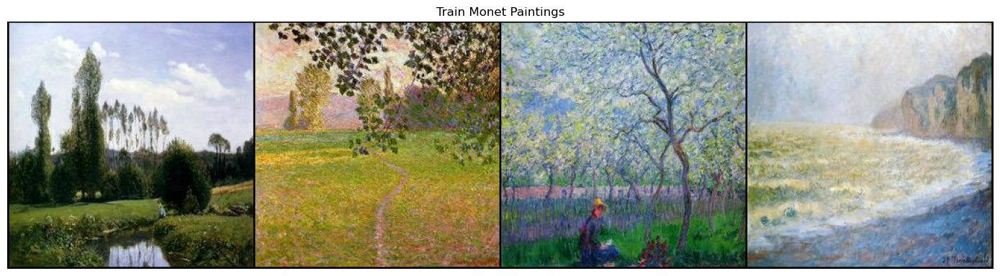

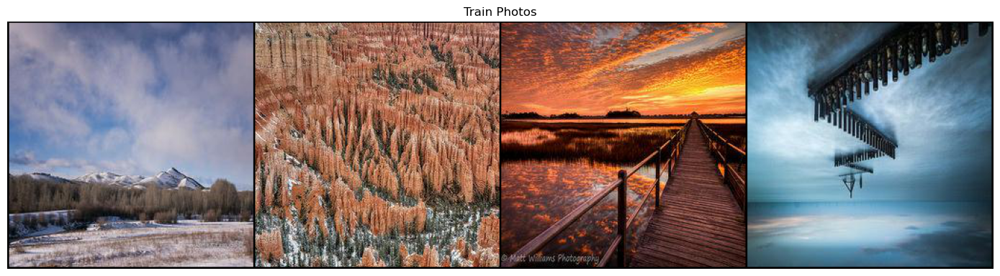

In [64]:
def visualize_batch(img_tensor, nrow, norm=True, title=''):
    
    img_tensor = img_tensor.detach().cpu()
    img_grid = vutils.make_grid(img_tensor, nrow=nrow, normalize=norm, scale_each=True)
    
    plt.figure(figsize=(14, 6))

    # premutations needed as .plt requires (256,256,3) formatting
    plt.imshow(img_grid.permute(1, 2, 0)) # CHW -> HWC
    plt.axis("off")
    plt.title(title)
    plt.tight_layout()
    plt.show()


data_sample = CustomDataLoader(monet_filenames, photo_filenames, batch_size=4)
Monet_loader, Photos_loader = data_sample.setup("train")

Monets = next(iter(Monet_loader))
Photos = next(iter(Photos_loader))

visualize_batch(Monets, nrow=4, title="Train Monet Paintings")
visualize_batch(Photos, nrow=4, title="Train Photos")


### Network auxiliary functions

The downsampling blocks use convolution layers to increase the number of feature maps while reducing the dimensions of the 2D image. On the other hand, the upsampling blocks contain transposed convolution layers, which combine the learned features to output an image with the original size.
The residual blocks have convolution layers where the original input is added to the output.

In [15]:
class Block(nn.Module):
    def __init__(self,
        in_channels, 
        out_channels, 
        down=True, 
        kernel_size = 4, 
        stride = 2,
        padding = 1, 
        output_padding = 0,
        act='leaky', 
        use_dropout=False, 
        norm=True,
    ):
        '''
        Initialize a Block, which can act as either a downsampling or upsampling layer, for that many arguments must be met.
        We decided to do this just to keep the networks building more understandable.

        Args:
            in_channels (int): Number of input channels.
            out_channels (int): Number of output channels.
            down (bool, optional): If True, performs downsampling using nn.Conv2d;
                                   otherwise, performs upsampling using nn.ConvTranspose2d. Defaults to True.
            kernel_size (int, optional): Size of the convolving kernel. Defaults to 4.
            stride (int, optional): Stride of the convolution. Defaults to 2.
            padding (int, optional): Zero-padding added to both sides of the input. Defaults to 1.
            output_padding (int, optional): Additional size added to one side of the output shape.
                                            Only used in transposed convolutions. Defaults to 0.
            act (str, optional): Activation function to use. Options are `'relu'`, `'leaky'`, or `None`. Defaults to `'relu'`.
            use_dropout (bool, optional): Whether to include a dropout layer with a dropout probability of 0.5.
                                          Defaults to False.
            norm (bool, optional): If True, uses`nn.InstanceNorm2d for normalization; Otherwise, no normalization layer. Defaults to True.
        '''
        
        super(Block, self).__init__()
        
        if down:
            conv = nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, stride=stride, padding=padding, bias=False)
        else:
            conv = nn.ConvTranspose2d( in_channels, out_channels, kernel_size=kernel_size, stride=stride, padding=padding, output_padding=output_padding, bias=False)
        
        # select activation function
        if act is not None:
            if act == 'relu':
                activation = nn.ReLU(inplace=True)
            elif act == 'leaky':
                activation = nn.LeakyReLU(0.2, inplace=True)

        # if considering normalization
        if norm:
            norm = nn.InstanceNorm2d(out_channels, affine=True)
            layers = [conv, norm]
        else:
            layers = [conv]
        
        if act is not None and down:
            layers.append(activation)
        
        # add dropout
        if use_dropout:
            layers.append(nn.Dropout(0.5))
            
        if not down and act is not None:
            layers.append(activation)

        # create a sequence of the above created layers
        self.block = nn.Sequential(*layers)
    
    def forward(self, x):
        return self.block(x) # apply sequence to input


class ResBlock(nn.Module):
    '''
    Initialize a Residual Block, which adds the input to the output of a convolutional block.

    This block consists of two sequential Block instances with reflection padding,
    enabling the model to learn residual mappings.

    Args:
        in_channels (int): Number of input (and output) channels.
        kernel_size (int, optional): Size of the convolving kernel for both `Block` instances.
                                        Defaults to 3.

    '''
    
    def __init__(self, in_channels, kernel_size=3, stride = 1):
        super(ResBlock, self).__init__()
        
        self.block = nn.Sequential(
            Block(in_channels, in_channels, down=True, kernel_size=kernel_size, stride=stride, padding='same', act='relu', norm=False),
            Block(in_channels, in_channels, down=True, kernel_size=kernel_size, stride=stride, padding='same', act=None, norm=False),
        )
        
    def forward(self, x):
        return torch.add(x, self.block(x))

In [16]:
class SelfAttention(nn.Module):
    '''
    Initialize the Self Attention Module to be used both in Generators and Discriminators.

    Args:
        in_dim (int): Number of input dimensions of attention layer. This will depend on where this layer is applied,
                      so no fixed number can be given to it.
    
    '''
    def __init__(self, in_dim):
        super(SelfAttention, self).__init__()
        self.in_dim = in_dim
        self.query = nn.Conv2d(in_dim, in_dim // 8, kernel_size=1)
        self.key = nn.Conv2d(in_dim, in_dim // 8, kernel_size=1)
        self.value = nn.Conv2d(in_dim, in_dim, kernel_size=1)
        self.gamma = nn.Parameter(torch.zeros(1)) # creates a learnable parameter to be updated when gradient descent is applied

    def forward(self, x):

        # get shapes of the batch and images to prepare queries, keys and values shapes
        batch_size, C, H, W = x.size()
        
        # we compute query, key, and value tensors
        # .view in order to reshape for attention calculation
        query = self.query(x).view(batch_size, -1, H * W).permute(0, 2, 1)  # (B, H*W, C/8)
        key = self.key(x).view(batch_size, -1, H * W)                       # (B, C/8, H*W)
        value = self.value(x).view(batch_size, -1, H * W)                   # (B, C, H*W)

        # build attention map
        attention = torch.bmm(query, key)  # (B, H*W, H*W)
        attention = torch.softmax(attention, dim=-1)  # Normalize along the last dimension

        # then, recombine weighted features
        out = torch.bmm(value, attention.permute(0, 2, 1))  # (B, C, H*W)
        out = out.view(batch_size, C, H, W)  # Reshape back to original size

        # apply scaling factor (learnable) and residual connection
        return self.gamma * out + x

In [17]:
class Discriminator(nn.Module):
    def __init__(self, in_channels=3, features=64):
        """
        This is the PatchGAN Discriminator class.
        It takes an image as input and determines whether it's real or fake.

        Args:
            in_channels (int, optional): The number of input channels (e.g., 3 for RGB images).
            features (int, optional): The number of features for the convolutional layers. 
                                       Defaults to 64.
        """
        super(Discriminator, self).__init__()

        # define the layers of the model
        self.model = nn.Sequential(
            # downsample and no normalization on first layer
            Block(in_channels, features, down=True, kernel_size=4, stride=2, padding=1, act='leaky', norm=False),   # Output: 64x128x128
            Block(features, features * 2, down=True, kernel_size=4, stride=2, padding=1, act='leaky', norm=True),  # Output: 128x64x64
            Block(features * 2, features * 4, down=True, kernel_size=4, stride=2, padding=1, act='leaky', norm=True),  # Output: 256x32x32
            nn.ZeroPad2d(1),  # Adds 1 pixel of padding on all sides. Output: 256x34x34
            Block(features * 4, features * 8, down=True, kernel_size=4, stride=1, padding=0, act='leaky', norm=True),  # Output: 512x31x31
            nn.ZeroPad2d(1),  # Output: 512x33x33
            # reduce the features to a single output channel resulting in a map.
            nn.Conv2d(features * 8, 1, kernel_size=4, stride=1)  # Output: 1x30x30
        )
        
        # initialize the weights for the layers
        self.initialize_weights()

    def forward(self, x):
        """
        Forward pass through the discriminator.

        Args:
            x: Input image (real or fake).

        Returns:
            The output after passing through the model.
            This is a "realness score" for each patch in the image.
        """
        return self.model(x)

    def initialize_weights(self):
        """
        Initialize the weights for all layers in the model.
        - For Conv2d and ConvTranspose2d layers: Use a normal distribution (mean=0.0, std=0.02).
        - For BatchNorm2d and InstanceNorm2d: Set weights to 1.0 and biases to 0.0.
        This ensures that the model starts with reasonable initial values.
        """
        for m in self.modules():
            if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
                nn.init.normal_(m.weight.data, 0.0, 0.02)
            elif isinstance(m, (nn.InstanceNorm2d)):
                if m.affine:
                    nn.init.normal_(m.weight, mean=0.0, std=0.02)
                    nn.init.constant_(m.bias, 0.0)


### Generator

A common architecture for the CycleGAN generator is the U-Net. U-Net is a network which consists of a sequence of downsampling blocks followed by a sequence of upsampling blocks, giving it the U-shaped architecture. In the upsampling path, we concatenate the outputs of the upsampling blocks and the outputs of the downsampling blocks symmetrically. This can be seen as a kind of skip connection, facilitating information flow in deep networks and reducing the impact of vanishing gradients.


In [19]:
class UNetGenerator(nn.Module):
    def __init__(self, in_channels=3, out_channels=3, features=64):
        """
        Initialize the U-Net Generator model using a series of downsampling and upsampling Blocks.

        Args:
            in_channels (int, optional): Number of input channels. Defaults to 3 (e.g., RGB images).
            features (int, optional): Base number of feature channels. Defaults to 64.
        """
        super(UNetGenerator, self).__init__()

        # downsampling Blocks
        self.initial_down = Block(in_channels, features, down=True, kernel_size=4, stride=2, padding=1, act='relu', norm=False) # 64x128x128       
        self.down1 = Block(features, features * 2, down=True, kernel_size=4, stride=2, padding=1, act='relu', norm=True)        # 128x64x64
        self.down2 = Block(features * 2, features * 4, down=True, kernel_size=4, stride=2, padding=1, act='relu', norm=True)    # 256x32x32
        self.down3 = Block(features * 4, features * 8, down=True, kernel_size=4, stride=2, padding=1, act='relu', norm=True)    # 512x16x16
        self.down4 = Block(features * 8, features * 8, down=True, kernel_size=4, stride=2, padding=1, act='relu', norm=True)    # 512x8x8
        self.down5 = Block(features * 8, features * 8, down=True, kernel_size=4, stride=2, padding=1, act='relu', norm=True)    # 512x4x4
        self.down6 = Block(features * 8, features * 8, down=True, kernel_size=4, stride=2, padding=1, act='relu', norm=True)    # 512x2x2

        # bottleneck layer (latent space - we have encoded features)
        self.bottleneck = Block(features * 8, features * 8, down=True, kernel_size=4, stride=2, padding=1, act='relu', norm=False) # 512x1x1

        # upsampling Blocks
        self.up1 = Block(features * 8, features * 8, down=False, kernel_size=4, stride=2, padding=1, act='relu', use_dropout=True, norm=True)  # (512+512)x2x2
        self.up2 = Block(features * 16, features * 8, down=False, kernel_size=4, stride=2, padding=1, act='relu', use_dropout=True, norm=True) # (512+512)x4x4
        self.up3 = Block(features * 16, features * 8, down=False, kernel_size=4, stride=2, padding=1, act='relu', use_dropout=True, norm=True) # (512+512)x8x8
        self.up4 = Block(features * 16, features * 8, down=False, kernel_size=4, stride=2, padding=1, act='relu', norm=True)                   # (512+512)x16x16 
        self.up5 = Block(features * 16, features * 4, down=False, kernel_size=4, stride=2, padding=1, act='relu', norm=True)                   # (256+256)x32x32
        self.up6 = Block(features * 8, features * 2, down=False, kernel_size=4, stride=2, padding=1, act='relu', norm=True)                    # (128+128)x64x64
        self.up7 = Block(features * 4, features, down=False, kernel_size=4, stride=2, padding=1, act='relu', norm=True)                        # (64+64)x128x128

        # final upsampling layer to reconstruct the image - we have decoded the information
        self.feature_block = nn.Sequential(
            nn.ConvTranspose2d(features*2, out_channels,
                               kernel_size=4, stride=2, padding=1), # 3x256x256
            nn.Tanh(), # activation function
        )

        # initialize weights
        self.initialize_weights()

    def forward(self, x):
        
        d1 = self.initial_down(x)  # 128
        d2 = self.down1(d1)        # 64
        d3 = self.down2(d2)        # 32
        d4 = self.down3(d3)        # 16
        d5 = self.down4(d4)        # 8
        d6 = self.down5(d5)        # 4
        d7 = self.down6(d6)        # 2

     
        bottleneck = self.bottleneck(d7)  # 1

        # torch.cat used for concatenating info from encoding part of the U-NET
        
        up1 = self.up1(bottleneck)                         # 2
        up2 = self.up2(torch.cat([up1, d7], dim=1))        # 4
        up3 = self.up3(torch.cat([up2, d6], dim=1))        # 8
        up4 = self.up4(torch.cat([up3, d5], dim=1))        # 16
        up5 = self.up5(torch.cat([up4, d4], dim=1))        # 32
        up6 = self.up6(torch.cat([up5, d3], dim=1))        # 64
        up7 = self.up7(torch.cat([up6, d2], dim=1))        # 128

        # Final upsampling and output
        return self.feature_block(torch.cat([up7, d1], dim=1))  # 256
        
    def initialize_weights(self):
        """
        Initialize the weights of the network.
        - For Conv2d and ConvTranspose2d: Initialize with normal distribution (mean=0.0, std=0.02).
        - For BatchNorm2d and InstanceNorm2d: Initialize weight to 1.0 and bias to 0.0.
        """
        for m in self.modules():
            if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
                nn.init.normal_(m.weight.data, 0.0, 0.02)
            elif isinstance(m, (nn.InstanceNorm2d)):
                if m.affine:
                    nn.init.normal_(m.weight, mean=0.0, std=0.02)
                    nn.init.constant_(m.bias, 0.0)

In the original CycleGAN implementation, the author used a ResNet generator. Similar to the U-Net architecture, the ResNet generator consists of the downsampling path and upsampling path. The difference is that the ResNet generator does not have the long skip connections from the concatenations of outputs. Instead, the ResNet generator uses residual blocks between the two paths. These residual blocks have short skip connections where the original input is added to the output.



In [21]:
class ResNetGenerator(nn.Module):
    def __init__(self, in_channels=3, out_channels=3, features=64, num_resblocks=6):
        """
        ResNet-based Generator with downsampling, residual blocks, and upsampling.

        Args:
            in_channels (int, optional): Number of input channels. Defaults to 3 (e.g., RGB images).
            features (int, optional): Base number of feature channels. Defaults to 64.
            num_resblocks (int, optional): Number of residual blocks in the bottleneck. Defaults to 6.
        """
        super(ResNetGenerator, self).__init__()

        # Initial downsampling layer
        self.initial_down = Block(in_channels, features, down=True, kernel_size=7, stride=1, padding='same', act='leaky', norm=False) # 64x256x256

        # Downsampling Blocks
        self.down1 = Block(features, features * 2, down=True, kernel_size=3, act='leaky') # 128x128x128
        self.down2 = Block(features*2, features * 4, down=True, kernel_size=3, act='leaky') # 256x64x64

        # Residual Blocks
        self.resblocks = nn.Sequential(
            *[ResBlock(features * 4) for _ in range(num_resblocks)] # 256x64x64
        )

        # Upsampling Blocks
        self.up1 = Block(features * 8, features * 2, down=False, kernel_size = 3, padding=1, output_padding=1, act='relu', norm=True) # 128x128x128
        self.up2 = Block(features * 4, features, down=False, kernel_size = 3, padding=1, output_padding=1, act='relu', norm=True) # 64x256x256

        # Final upsampling layer to reconstruct the image
        self.final_up = nn.Sequential(
            nn.Conv2d(features*2, out_channels, kernel_size=7, stride=1, padding=3, bias=False), # 3x256x256
            nn.Tanh()
        )

        # Initialize weights
        self.initialize_weights()

    def forward(self, x):
        # Downsampling
        d1 = self.initial_down(x)  # 256
        d2 = self.down1(d1)        # 128
        d3 = self.down2(d2)        # 64

        # Residual Blocks
        res = self.resblocks(d3)   # 64

        skip1 = torch.cat([res, d3], dim=1)

        # Upsampling
        up1 = self.up1(skip1)        # 128

        skip2 = torch.cat([up1, d2], dim=1)
        
        up2 = self.up2(skip2)        # 256
        
        skip3 = torch.cat([up2, d1], dim=1)

        # Final output
        return self.final_up(skip3)

    def initialize_weights(self):
        """
        Initialize the weights of the network.
        - For Conv2d and ConvTranspose2d: Initialize with normal distribution (mean=0.0, std=0.02).
        - For BatchNorm2d and InstanceNorm2d: Initialize weight to 1.0 and bias to 0.0.
        """
        for m in self.modules():
            if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
                nn.init.normal_(m.weight.data, 0.0, 0.02)
            elif isinstance(m, nn.InstanceNorm2d):
                if m.affine:
                    nn.init.normal_(m.weight, mean=0.0, std=0.02)
                    nn.init.constant_(m.bias, 0.0)

# Self-Attention UNET Generator

### Why Self-Attention in GANs?

Self-attention allows the model to focus on global dependencies in the image, such as capturing long-range features like the overall color palette, shapes, or brushstrokes. This is especially useful for tasks like artistic style transfer, where both local and global features are critical.

Attention can be added to both the downsampling (to focus on key image features) and upsampling (to ensure consistency in reconstruction). Here's the updated implementation:

In [23]:
class UNetAttentionGenerator(nn.Module):
    def __init__(self, in_channels=3, out_channels=3, features=64):
        super(UNetAttentionGenerator, self).__init__()

        # Downsampling Blocks
        self.initial_down = Block(in_channels, features, down=True, kernel_size=4, stride=2, padding=1, act='relu', norm=False) # 64x128x128       
        self.down1 = Block(features, features * 2, down=True, kernel_size=4, stride=2, padding=1, act='relu', norm=True)        # 128x64x64
        self.down2 = Block(features * 2, features * 4, down=True, kernel_size=4, stride=2, padding=1, act='relu', norm=True)    # 256x32x32
        self.down3 = Block(features * 4, features * 8, down=True, kernel_size=4, stride=2, padding=1, act='relu', norm=True)    # 512x16x16
        self.down4 = Block(features * 8, features * 8, down=True, kernel_size=4, stride=2, padding=1, act='relu', norm=True)    # 512x8x8
        self.down5 = Block(features * 8, features * 8, down=True, kernel_size=4, stride=2, padding=1, act='relu', norm=True)    # 512x4x4
        self.down6 = Block(features * 8, features * 8, down=True, kernel_size=4, stride=2, padding=1, act='relu', norm=True)    # 512x2x2

        # Bottleneck layer
        self.bottleneck = Block(features * 8, features * 8, down=True, kernel_size=4, stride=2, padding=1, act='relu', norm=False) # 512x1x1

        # Self-Attention in Bottleneck
        self.attention_bottleneck = SelfAttention(features * 8)

        # Upsampling Blocks
        self.up1 = Block(features * 8, features * 8, down=False, kernel_size=4, stride=2, padding=1, act='relu', use_dropout=True, norm=True)  # (512+512)x2x2
        self.up2 = Block(features * 16, features * 8, down=False, kernel_size=4, stride=2, padding=1, act='relu', use_dropout=True, norm=True) # (512+512)x4x4
        self.up3 = Block(features * 16, features * 8, down=False, kernel_size=4, stride=2, padding=1, act='relu', use_dropout=True, norm=True) # (512+512)x8x8
        self.up4 = Block(features * 16, features * 8, down=False, kernel_size=4, stride=2, padding=1, act='relu', norm=True)                   # (512+512)x16x16
        self.up5 = Block(features * 16, features * 4, down=False, kernel_size=4, stride=2, padding=1, act='relu', norm=True)                   # (256+256)x32x32
        self.up6 = Block(features * 8, features * 2, down=False, kernel_size=4, stride=2, padding=1, act='relu', norm=True)                    # (128+128)x64x64
        self.up7 = Block(features * 4, features, down=False, kernel_size=4, stride=2, padding=1, act='relu', norm=True)                        # (64+64)x128x128

        # Self-Attention in Decoder
        self.attention_up5 = SelfAttention(features * 4)
        self.attention_up6 = SelfAttention(features * 2)

        # Final upsampling layer to reconstruct the image
        self.feature_block = nn.Sequential(
            nn.ConvTranspose2d(features * 2, out_channels,
                               kernel_size=4, stride=2, padding=1), # 3x256x256
            nn.Tanh(),
        )

        # Initialize weights
        self.initialize_weights()

    def forward(self, x):
        # Downsampling
        d1 = self.initial_down(x)  # 128
        d2 = self.down1(d1)        # 64
        d3 = self.down2(d2)        # 32
        d4 = self.down3(d3)        # 16
        d5 = self.down4(d4)        # 8
        d6 = self.down5(d5)        # 4
        d7 = self.down6(d6)        # 2

        # Bottleneck
        bottleneck = self.attention_bottleneck(self.bottleneck(d7))  # Apply self-attention in bottleneck

        # Upsampling with skip connections
        up1 = self.up1(bottleneck)                         # 2
        up2 = self.up2(torch.cat([up1, d7], dim=1))        # 4
        up3 = self.up3(torch.cat([up2, d6], dim=1))        # 8
        up4 = self.up4(torch.cat([up3, d5], dim=1))        # 16
        up5 = self.attention_up5(self.up5(torch.cat([up4, d4], dim=1)))  # Apply self-attention
        up6 = self.attention_up6(self.up6(torch.cat([up5, d3], dim=1)))  # Apply self-attention
        up7 = self.up7(torch.cat([up6, d2], dim=1))        # 128

        # Final upsampling and output
        return self.feature_block(torch.cat([up7, d1], dim=1))  # 256
        
    def initialize_weights(self):
        for m in self.modules():
            if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
                nn.init.normal_(m.weight.data, 0.0, 0.02)
            elif isinstance(m, (nn.InstanceNorm2d)):
                if m.affine:
                    nn.init.normal_(m.weight, mean=0.0, std=0.02)
                    nn.init.constant_(m.bias, 0.0)

### Image buffer

The original CycleGAN implementation updates the discriminator using a history of generated images instead of the latest images generated. This is done by setting up an image buffer that stores previously generated images. With probability 0.5, each newly generated image is swapped with a previously generated image stored in the buffer. This stabilizes training by giving the discriminator access to past information.

In [25]:
class ImageBuffer:
    def __init__(self, max_size: int):
        """
        Initializes the ImageBuffer.

        Args:
            max_size (int): Maximum number of images to store in the buffer.
        """
        self.max_size = max_size
        self.images: list[torch.Tensor] = [] if max_size > 0 else None

    def __call__(self, input_images):
        if not self.max_size:
            return input_images

        processed_images = []
        for img in input_images:
            img = img.unsqueeze(0)
            if len(self.images) < self.max_size:
                self.images.append(img)
                processed_images.append(img)
            else:
                if np.random.rand() > 0.5:
                    replace_idx = np.random.randint(0, self.max_size)
                    replaced_img = self.images[replace_idx].clone()
                    self.images[replace_idx] = img
                    processed_images.append(replaced_img)
                else:
                    processed_images.append(img)
        return torch.cat(processed_images, dim=0)

In [26]:
class Trainer:
    def __init__(self,
        monet_train_loader,
        photo_train_loader,
        monet_val_loader,
        photo_val_loader,
        Gen_M2P,
        Gen_P2M,
        Disc_Monet,
        Disc_Photo,
        epochs,
        lambda_id = 5,
        lambda_cycle = 15,
        max_buffer_size = 100,
        save_path = "checkpoints"
        
    ):
        """
        Initialize the Trainer with data loaders, models, training parameters, and device configuration.
        """
        self.monet_train_loader = monet_train_loader
        self.photo_train_loader = photo_train_loader
        self.monet_val_loader = monet_val_loader
        self.photo_val_loader = photo_val_loader
        
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.scaler = torch.amp.GradScaler('cuda')
        print(self.device)
    
        self.Gen_M2P = Gen_M2P.to(self.device)       # Generator: Monet -> Photo
        self.Gen_P2M = Gen_P2M.to(self.device)       # Generator: Photo -> Monet
        self.Disc_Monet = Disc_Monet.to(self.device)   # Discriminator for Monet
        self.Disc_Photo = Disc_Photo.to(self.device)   # Discriminator for Photo

        self.buffer_fake_Monet = ImageBuffer(max_buffer_size)
        self.buffer_fake_Photo = ImageBuffer(max_buffer_size)
        
        self.train_g_losses = []
        self.train_d_monet_losses = []
        self.train_d_photo_losses = []
        self.val_g_losses = []
        self.val_d_monet_losses = []
        self.val_d_photo_losses = []
        # self.MiFID_list = []
        # self.IS_list = []
        
        self.epochs = epochs
        self.lambda_id = lambda_id
        self.lambda_cycle = lambda_cycle
        self.save_path = Path(save_path)
        self.save_path.mkdir(parents=True, exist_ok=True)  # Create directory if it doesn't exist
    
        # 1 batch for consistent samples to visualize each epoch
        self.fixed_real_Monet = next(iter(monet_val_loader)).to(self.device)  
        self.fixed_real_Photo = next(iter(photo_val_loader)).to(self.device)
    
        # Initialize losses and optimizers
        self.init_losses()
        self.init_optimizers()

    def init_optimizers(self, lr: float = 2e-4, betas: tuple = (0.5, 0.999)):
        """
        Initialize the optimizers for the generators and discriminators.
        """
        # self.optimizer_Gen = optim.Adam(
        #     itertools.chain(self.Gen_M2P.parameters(), self.Gen_P2M.parameters()),
        #     lr=lr,
        #     betas=betas
        # )
        
        self.optimizer_Gen_M2P = optim.Adam(
            self.Gen_M2P.parameters(),
            lr=lr,
            betas=betas
        )
        self.optimizer_Gen_P2M = optim.Adam(
            self.Gen_P2M.parameters(),
            lr=lr,
            betas=betas
        )
        self.optimizer_Disc_Monet = optim.Adam(
            self.Disc_Monet.parameters(),
            lr=lr,
            betas=betas
        )
        self.optimizer_Disc_Photo = optim.Adam(
            self.Disc_Photo.parameters(),
            lr=lr,
            betas=betas
        )
                
        self.scheduler_Gen_M2P = optim.lr_scheduler.ReduceLROnPlateau(self.optimizer_Gen_M2P, mode='min', factor=0.5, patience=2, min_lr=0)
        self.scheduler_Gen_P2M = optim.lr_scheduler.ReduceLROnPlateau(self.optimizer_Gen_P2M, mode='min', factor=0.5, patience=2, min_lr=0)
        self.scheduler_Disc_Monet = optim.lr_scheduler.ReduceLROnPlateau(self.optimizer_Disc_Monet, mode='min', factor=0.5, patience=2, min_lr=0)
        self.scheduler_Disc_Photo = optim.lr_scheduler.ReduceLROnPlateau(self.optimizer_Disc_Photo, mode='min', factor=0.5, patience=2, min_lr=0)


    def init_losses(self):
        """
        Initialize the loss functions used for training.
        """
        self.criterion_gan = nn.MSELoss()       # Adversarial loss (LSGAN style)
        # self.criterion_gan = nn.BCEWithLogitsLoss()
        self.criterion_cycle = nn.L1Loss()      # Cycle consistency loss
        self.criterion_identity = nn.L1Loss()   # Identity loss
        print(self.criterion_gan)

    def gan_loss(self, fake, disc):
        pred = disc(fake)
        loss = self.criterion_gan(pred, torch.ones_like(pred))
        return loss

    def identity_loss(self, real, same):
        loss = self.criterion_identity(same, real)
        return self.lambda_id * loss * 0.5

    def cycle_loss(self, real, cycled):
        loss = self.criterion_cycle(real, cycled)
        return self.lambda_cycle * loss
    
    def total_cycle_loss(self, real_Monet, real_Photo, cycled_Monet, cycled_Photo):
        cycle_loss_M2P2M = self.cycle_loss(real_Monet, cycled_Monet)
        cycle_loss_P2M2P = self.cycle_loss(real_Photo, cycled_Photo)
        return cycle_loss_M2P2M + cycle_loss_P2M2P
    
    def total_identity_loss(self, real_Monet, real_Photo, same_Monet, same_Photo):
        identity_loss_M2M = self.identity_loss(real_Monet, same_Monet)
        identity_loss_P2P = self.identity_loss(real_Photo, same_Photo)
        return identity_loss_M2M + identity_loss_P2P

    def generator_loss(self, real_Monet, real_Photo, fake_Monet, fake_Photo, same_Monet, same_Photo, cycled_Monet, cycled_Photo):
        gan_loss_P2M = self.gan_loss(fake_Monet, self.Disc_Monet)
        gan_loss_M2P = self.gan_loss(fake_Photo, self.Disc_Photo)
        total_gan_loss = gan_loss_P2M + gan_loss_M2P

        total_identity_loss = self.total_identity_loss(real_Monet, real_Photo, same_Monet, same_Photo)
    
        total_cycle_loss = self.total_cycle_loss(real_Monet, real_Photo, cycled_Monet, cycled_Photo)

        return total_gan_loss + total_cycle_loss + total_identity_loss
    
    def discriminator_loss(self, real, fake, disc):
        # Loss on real images
        real_pred = disc(real)
        real_loss = self.criterion_gan(real_pred, torch.ones_like(real_pred))
    
        # Loss on fake images
        fake_pred = disc(fake.detach())
        fake_loss = self.criterion_gan(fake_pred, torch.zeros_like(fake_pred))
    
        # Combine losses
        disc_loss = (fake_loss + real_loss) * 0.5
        return disc_loss

    def discriminator_loss_Monet(self, real, fake, disc):
        fake = self.buffer_fake_Monet(fake)
        return self.discriminator_loss(real, fake, disc)

    def discriminator_loss_Photo(self, real, fake, disc):
        fake = self.buffer_fake_Photo(fake)
        return self.discriminator_loss(real, fake, disc)
    
    def train(self):
        
        self.best_val_g_loss = float('inf')
        self.epochs_no_improve = 0
        self.patience = 5

        for epoch in range(self.epochs):            
            self.Gen_M2P.train()
            self.Gen_P2M.train()
            self.Disc_Monet.train()
            self.Disc_Photo.train()

            train_metrics = {"G_loss": 0, "D_Monet_loss": 0, "D_Photo_loss": 0}
    
            # Use tqdm for the training loop
            progress_bar = tqdm(
                zip(self.monet_train_loader, self.photo_train_loader),
                desc=f"Epoch [{epoch+1}/{self.epochs}]",
                total=min(len(self.monet_train_loader), len(self.photo_train_loader)),
                leave=False
            )
    
            for real_Monet, real_Photo in progress_bar:
                real_Monet, real_Photo = real_Monet.to(self.device), real_Photo.to(self.device)
    
                with torch.amp.autocast('cuda'):
                    fake_Photo = self.Gen_M2P(real_Monet)
                    fake_Monet = self.Gen_P2M(real_Photo)
                    cycle_Monet = self.Gen_P2M(fake_Photo)
                    cycle_Photo = self.Gen_M2P(fake_Monet)
                    same_Monet = self.Gen_P2M(real_Monet)
                    same_Photo = self.Gen_M2P(real_Photo)

                    g_loss = self.generator_loss(
                        real_Monet, real_Photo, fake_Monet, fake_Photo, same_Monet, same_Photo, cycle_Monet, cycle_Photo
                    )
                
                # self.optimizer_Gen.zero_grad()
                # g_loss.backward()
                # self.optimizer_Gen.step()
                # train_metrics["G_loss"] += g_loss.item()
                
                # Update Gen_M2P and Gen_P2M separately
                self.optimizer_Gen_M2P.zero_grad()
                self.optimizer_Gen_P2M.zero_grad()
                self.scaler.scale(g_loss).backward()
                self.scaler.step(self.optimizer_Gen_M2P)
                self.scaler.step(self.optimizer_Gen_P2M)
                self.scaler.update()
                
                train_metrics["G_loss"] += g_loss.item()
                   
                with torch.amp.autocast('cuda'):
                    d_monet_loss = self.discriminator_loss_Monet(real_Monet, fake_Monet, self.Disc_Monet)
                    d_photo_loss = self.discriminator_loss_Photo(real_Photo, fake_Photo, self.Disc_Photo)
                
                self.optimizer_Disc_Monet.zero_grad()
                self.scaler.scale(d_monet_loss).backward()
                self.scaler.step(self.optimizer_Disc_Monet)
                
                self.optimizer_Disc_Photo.zero_grad()
                self.scaler.scale(d_photo_loss).backward()
                self.scaler.step(self.optimizer_Disc_Photo)
                self.scaler.update()
    
                train_metrics["D_Monet_loss"] += d_monet_loss.item()
                train_metrics["D_Photo_loss"] += d_photo_loss.item()
    
                # Update tqdm description with current metrics
                progress_bar.set_postfix(
                    G_loss=train_metrics["G_loss"] / (progress_bar.n + 1),
                    D_Monet_loss=train_metrics["D_Monet_loss"] / (progress_bar.n + 1),
                    D_Photo_loss=train_metrics["D_Photo_loss"] / (progress_bar.n + 1),
                )
    
            # Normalize training metrics
            for key in train_metrics:
                train_metrics[key] /= len(self.monet_train_loader)
            
            avg_train_g_loss = train_metrics["G_loss"]
            avg_train_d_monet_loss = train_metrics["D_Monet_loss"]
            avg_train_d_photo_loss = train_metrics["D_Photo_loss"]

    
            self.train_g_losses.append(avg_train_g_loss)
            self.train_d_monet_losses.append(avg_train_d_monet_loss)
            self.train_d_photo_losses.append(avg_train_d_photo_loss)
    
            print(f"Epoch [{epoch+1}/{self.epochs}] - G_loss: {train_metrics['G_loss']:.4f}, "
                  f"D_Monet_loss: {train_metrics['D_Monet_loss']:.4f}, "
                  f"D_Photo_loss: {train_metrics['D_Photo_loss']:.4f}")
    
            # Validation
            self.Gen_M2P.eval()
            self.Gen_P2M.eval()
            val_metrics = {"G_loss": 0, "D_Monet_loss": 0, "D_Photo_loss": 0}
            num_batches = min(len(self.monet_val_loader), len(self.photo_val_loader))
    
            with torch.no_grad():
                progress_bar_val = tqdm(
                    zip(self.monet_val_loader, self.photo_val_loader),
                    desc=f"Validation [{epoch+1}/{self.epochs}]",
                    total=num_batches,
                    leave=False
                )
    
                for real_Monet, real_Photo in progress_bar_val:
                    real_Monet, real_Photo = real_Monet.to(self.device), real_Photo.to(self.device)
    
                    with torch.amp.autocast('cuda'):  # Mixed precision for validation
                        # Generate fake and cycle images
                        fake_Photo = self.Gen_M2P(real_Monet)
                        fake_Monet = self.Gen_P2M(real_Photo)
                        cycle_Monet = self.Gen_P2M(fake_Photo)
                        cycle_Photo = self.Gen_M2P(fake_Monet)
            
                        # Identity images
                        same_Monet = self.Gen_P2M(real_Monet)
                        same_Photo = self.Gen_M2P(real_Photo)
            
                        # Compute losses
                        g_loss = self.generator_loss(
                            real_Monet, real_Photo, fake_Monet, fake_Photo, same_Monet, same_Photo, cycle_Monet, cycle_Photo
                        )
                    
                    val_metrics["G_loss"] += g_loss.item()

                    with torch.amp.autocast('cuda'):
                        d_monet_loss = self.discriminator_loss(real_Monet, fake_Monet, self.Disc_Monet)
                        d_photo_loss = self.discriminator_loss(real_Photo, fake_Photo, self.Disc_Photo)
                        
                    val_metrics["D_Monet_loss"] += d_monet_loss.item()
                    val_metrics["D_Photo_loss"] += d_photo_loss.item()
    
                    # Update tqdm description with current validation metrics
                    progress_bar_val.set_postfix(
                        G_loss=val_metrics["G_loss"] / (progress_bar_val.n + 1),
                        D_Monet_loss=val_metrics["D_Monet_loss"] / (progress_bar_val.n + 1),
                        D_Photo_loss=val_metrics["D_Photo_loss"] / (progress_bar_val.n + 1),
                    )


            # Normalize validation metrics
            for key in val_metrics:
                val_metrics[key] /= num_batches
            
            avg_val_g_loss = val_metrics["G_loss"]
            avg_val_d_monet_loss = val_metrics["D_Monet_loss"]
            avg_val_d_photo_loss = val_metrics["D_Photo_loss"]
    
            self.val_g_losses.append(avg_val_g_loss)
            self.val_d_monet_losses.append(avg_val_d_monet_loss)
            self.val_d_photo_losses.append(avg_val_d_photo_loss)
    
            print(f"Validation - G_loss: {val_metrics['G_loss']:.4f}, "
                  f"D_Monet_loss: {val_metrics['D_Monet_loss']:.4f}, "
                  f"D_Photo_loss: {val_metrics['D_Photo_loss']:.4f}")


            # #####################################################################################
            # # MiFID and Inception Score at each epoch

            # # pick a batch of images from the validation dataloader
            # for batch in self.monet_val_loader:
            #     real_monet_images = batch
            #     break

            # # pick a batch of images from the validation dataloader
            # for batch in self.photo_val_loader:
            #     real_photo_images = batch
            #     break
        
            # real_Monet, real_Photo = real_monet_images.to(self.device), real_photo_images.to(self.device)

            # with torch.no_grad():
            #     with torch.amp.autocast('cuda'):  # Mixed precision for validation
            #         # Generate fake
            #         fake_Monet = self.Gen_P2M(real_Photo)
                    
            #         # MiFID and Inception Score at each epoch
            #         fake_Monet_mifid = fake_Monet * 0.5 + 0.5
            #         real_Monet_mifid = real_Monet * 0.5 + 0.5
                    
            #         mifid = MemorizationInformedFrechetInceptionDistance(feature=2048,normalize=True).to(self.device)
            #         mifid.update(real_Monet_mifid, real=True)
            #         mifid.update(fake_Monet_mifid, real=False)
            #         mifid = mifid.compute().item()
            #         mifid.reset()
            #         print("MiFID score:", mifid)
            #         self.MiFID_list.append(mifid)
                    
            #         inception = InceptionScore(feature=2048,normalize=True).to(self.device)
            #         inception.update(fake_Monet_mifid)
            #         incept_score = inception.compute()[0].item()
            #         print("Inception Score:",incept_score)
            #         self.IS_list.append(incept_score)

            #         # free memory
            #         del fake_Monet
            #         del fake_Monet_mifid
            #         del real_Monet_mifid

            # ####################################################################################
            
            # Save model checkpoints
            if avg_val_g_loss < self.best_val_g_loss:
                self.best_val_g_loss = avg_val_g_loss
                self.save_models(epoch)
                self.best_epoch = epoch + 1
                self.epochs_no_improve = 0
                print(f"Best model updated at epoch {epoch + 1} with Val G_loss: {avg_val_g_loss:.4f}")
            else:
                self.epochs_no_improve += 1
                print(f"No improvement in validation G_loss for {self.epochs_no_improve} epoch(s).")

                if self.epochs_no_improve >= self.patience:
                    print(f"Early stopping triggered after {self.patience} epochs with no improvement.")
                    break

                
            self.scheduler_Gen_M2P.step(avg_val_g_loss)
            self.scheduler_Gen_P2M.step(avg_val_g_loss)
            self.scheduler_Disc_Monet.step(avg_val_d_monet_loss)
            self.scheduler_Disc_Photo.step(avg_val_d_photo_loss)
            
            current_lr = self.scheduler_Gen_M2P.get_last_lr()
            print(f"Current Gen_M2P LR: {current_lr[0]:.6f}")
            current_lr = self.scheduler_Gen_P2M.get_last_lr()
            print(f"Current Gen_P2M LR: {current_lr[0]:.6f}")            
            current_lr = self.scheduler_Disc_Monet.get_last_lr()
            print(f"Current Disc_Monet LR: {current_lr[0]:.6f}")
            current_lr = self.scheduler_Disc_Photo.get_last_lr()
            print(f"Current Disc_Photo LR: {current_lr[0]:.6f}")
            
            # Generate and plot images for fixed Monet and fixed Photo
            self.plot_images(epoch)
    
        self.plot_losses()
        #self.plot_metrics()
    
    def plot_images(self, epoch):
        # Generate fake, cycle, and identity images
        with torch.no_grad():
            fake_Photo = self.Gen_M2P(self.fixed_real_Monet)
            fake_Monet = self.Gen_P2M(self.fixed_real_Photo)
            cycle_Monet = self.Gen_P2M(fake_Photo)
            cycle_Photo = self.Gen_M2P(fake_Monet)
            same_Monet = self.Gen_P2M(self.fixed_real_Monet)
            same_Photo = self.Gen_M2P(self.fixed_real_Photo)

        # Collect all images into a list
        images = [
            self.fixed_real_Monet[0],  # Original Monet
            fake_Photo[0],              # Generated Photo
            same_Monet[0],              # Identity Monet
            cycle_Monet[0],             # Cycle Monet
            self.fixed_real_Photo[0],   # Original Photo
            fake_Monet[0],              # Generated Monet
            same_Photo[0],              # Identity Photo
            cycle_Photo[0]               # Cycle Photo
        ]

        # Define corresponding labels for each image
        labels = [
            "Original Monet",
            "Generated Photo",
            "Identity Monet",
            "Cycle Monet",
            "Original Photo",
            "Generated Monet",
            "Identity Photo",
            "Cycle Photo"
        ]

        # Manually denormalize the images from [-1, 1] to [0, 1]
        images = [(img + 1) / 2 for img in images]

        # Create subplots
        fig, axes = plt.subplots(2, 4, figsize=(20, 10))
        for idx, ax in enumerate(axes.flatten()):
            img = images[idx].permute(1, 2, 0).cpu().numpy()
            ax.imshow(img)
            ax.set_title(labels[idx], fontsize=12)
            ax.axis('off')

        plt.suptitle(f'Image Results at Epoch {epoch+1}', fontsize=16)
        plt.tight_layout()
        plt.show()
        
    # def plot_metrics(self):
    #     '''
    #     Plotting the MiFID and Inception Score metrics of the P2M Generator.
    #     '''
    #     epochs_range = range(1, len(self.MiFID_list) + 1)
        
    #     plt.figure(figsize=(12, 8))
        
    #     plt.subplot(2, 1, 1)
    #     plt.plot(epochs_range, self.MiFID_list, label='MiFID', color='blue')
    #     plt.title("MiFID Evolution")
    #     plt.xlabel("Epochs")
    #     plt.ylabel("MiFID")
    #     plt.legend()

    #     plt.figure(figsize=(12, 8))
        
    #     plt.subplot(2, 1, 2)
    #     plt.plot(epochs_range, self.IS_list, label='Inception Score', color='blue')
    #     plt.title("Inception Score Evolution")
    #     plt.xlabel("Epochs")
    #     plt.ylabel("Inception Score")
    #     plt.legend()

        
    def plot_losses(self):
        """
        Plot the training and validation losses for G, D_Monet, and D_Photo.
        """
        epochs_range = range(1, len(self.val_g_losses) + 1)
        
        plt.figure(figsize=(12, 8))

        # Generator losses
        plt.subplot(3, 1, 1)
        plt.plot(epochs_range, self.train_g_losses, label='Train G Loss', color='blue')
        plt.plot(epochs_range, self.val_g_losses, label='Validation G Loss', color='red')
        plt.title("Generator Loss")
        plt.xlabel("Epochs")
        plt.ylabel("Loss")
        plt.legend()

        # Discriminator Monet losses
        plt.subplot(3, 1, 2)
        plt.plot(epochs_range, self.train_d_monet_losses, label='Train D_Monet Loss', color='blue')
        plt.plot(epochs_range, self.val_d_monet_losses, label='Validation D_Monet Loss', color='red')
        plt.title("Discriminator Monet Loss")
        plt.xlabel("Epochs")
        plt.ylabel("Loss")
        plt.legend()

        # Discriminator Photo losses
        plt.subplot(3, 1, 3)
        plt.plot(epochs_range, self.train_d_photo_losses, label='Train D_Photo Loss', color='blue')
        plt.plot(epochs_range, self.val_d_photo_losses, label='Validation D_Photo Loss', color='red')
        plt.title("Discriminator Photo Loss")
        plt.xlabel("Epochs")
        plt.ylabel("Loss")
        plt.legend()

        # Show the plots
        plt.tight_layout()
        plt.show()

    def save_models(self, epoch):
        torch.save(self.Gen_M2P.state_dict(), self.save_path / f"Gen_M2P_epoch{epoch+1}.pth")
        torch.save(self.Gen_P2M.state_dict(), self.save_path / f"Gen_P2M_epoch{epoch+1}.pth")
        torch.save(self.Disc_Monet.state_dict(), self.save_path / f"Disc_Monet_epoch{epoch+1}.pth")
        torch.save(self.Disc_Photo.state_dict(), self.save_path / f"Disc_Photo_epoch{epoch+1}.pth")
        print(f"Models saved at epoch {epoch + 1}")
    
    def load_model(self, epoch=None):
        """
        Load saved model weights.
        If epoch is None, load the latest checkpoint.
        """
        if epoch is not None:
            gen_m2p_path = self.save_path / f"Gen_M2P_epoch{epoch}.pth"
            gen_p2m_path = self.save_path / f"Gen_P2M_epoch{epoch}.pth"
            d_monet_path = self.save_path / f"Disc_Monet_epoch{epoch}.pth"
            d_photo_path = self.save_path / f"Disc_Photo_epoch{epoch}.pth"
        else:
            # Find the latest checkpoint based on epoch numbering
            checkpoint_files = list(self.save_path.glob("*.pth"))
            if not checkpoint_files:
                raise FileNotFoundError("No checkpoint files found to load.")
            
            # Extract epoch numbers from filenames
            def extract_epoch(file_path):
                try:
                    return int(file_path.stem.split('epoch')[-1])
                except ValueError:
                    return -1  # Invalid epoch
            
            latest_epoch = max(extract_epoch(f) for f in checkpoint_files)
            if latest_epoch == -1:
                raise ValueError("No valid epoch numbers found in checkpoint filenames.")
            
            gen_m2p_path = self.save_path / f"Gen_M2P_epoch{latest_epoch}.pth"
            gen_p2m_path = self.save_path / f"Gen_P2M_epoch{latest_epoch}.pth"
            d_monet_path = self.save_path / f"Disc_Monet_epoch{latest_epoch}.pth"
            d_photo_path = self.save_path / f"Disc_Photo_epoch{latest_epoch}.pth"

        # Function to load a state dict
        def load_state(model, path):
            if not path.exists():
                raise FileNotFoundError(f"Checkpoint file {path} does not exist.")
            state_dict = torch.load(path, map_location=self.device, weights_only=True)
            model.load_state_dict(state_dict)
            model.to(self.device)
            print(f"Loaded model from {path} to {self.device}")

        # Load each model outside the load_state function
        load_state(self.Gen_M2P, gen_m2p_path)
        load_state(self.Gen_P2M, gen_p2m_path)
        load_state(self.Disc_Monet, d_monet_path)
        load_state(self.Disc_Photo, d_photo_path)

        print("All models loaded successfully.")

In [27]:
epochs = 20
Gen_M2P = UNetAttentionGenerator()
Gen_P2M = UNetAttentionGenerator()
Disc_Monet = Discriminator()
Disc_Photo = Discriminator()

cuda
MSELoss()


Epoch [1/20] - G_loss: 4.9274, D_Monet_loss: 0.1650, D_Photo_loss: 0.1651


Validation - G_loss: 3.9960, D_Monet_loss: 0.2129, D_Photo_loss: 0.1918
Models saved at epoch 1
Best model updated at epoch 1 with Val G_loss: 3.9960
Current Gen_M2P LR: 0.000200
Current Gen_P2M LR: 0.000200
Current Disc_Monet LR: 0.000200
Current Disc_Photo LR: 0.000200


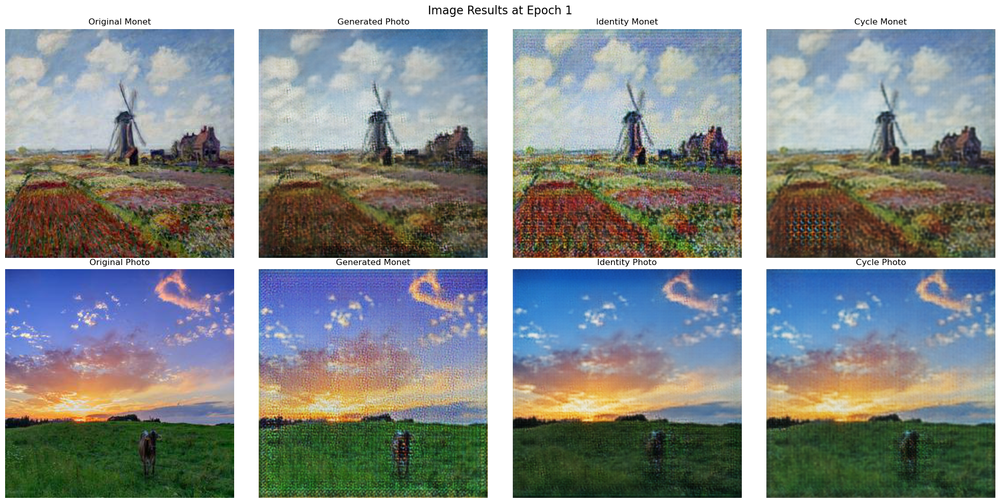

Epoch [2/20] - G_loss: 3.7182, D_Monet_loss: 0.1729, D_Photo_loss: 0.1741


Validation - G_loss: 3.6576, D_Monet_loss: 0.1913, D_Photo_loss: 0.2111
Models saved at epoch 2
Best model updated at epoch 2 with Val G_loss: 3.6576
Current Gen_M2P LR: 0.000200
Current Gen_P2M LR: 0.000200
Current Disc_Monet LR: 0.000200
Current Disc_Photo LR: 0.000200


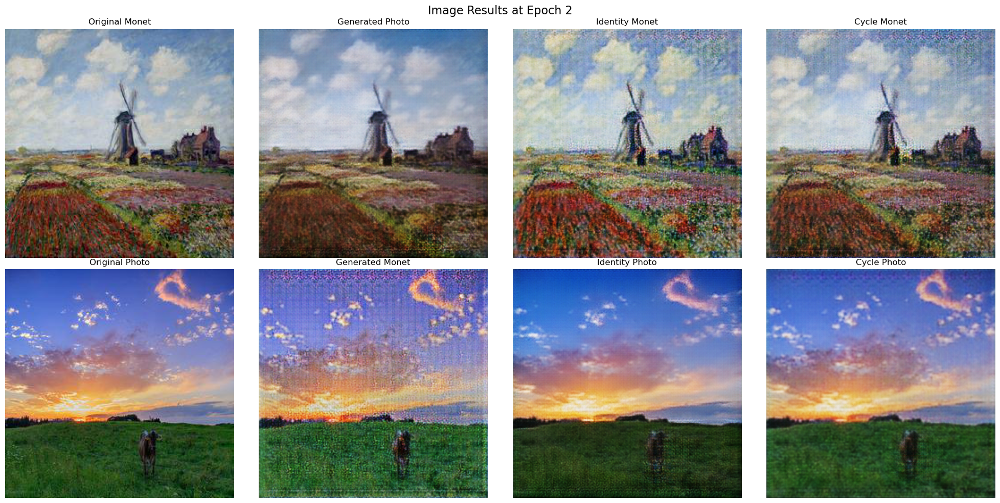

Epoch [3/20] - G_loss: 3.5037, D_Monet_loss: 0.1641, D_Photo_loss: 0.1647


Validation - G_loss: 3.2630, D_Monet_loss: 0.1890, D_Photo_loss: 0.1888
Models saved at epoch 3
Best model updated at epoch 3 with Val G_loss: 3.2630
Current Gen_M2P LR: 0.000200
Current Gen_P2M LR: 0.000200
Current Disc_Monet LR: 0.000200
Current Disc_Photo LR: 0.000200


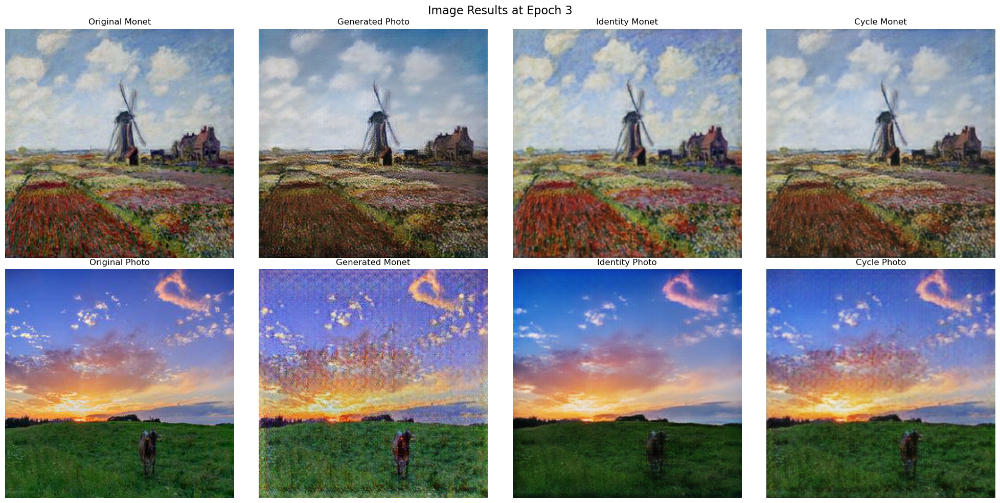

Epoch [4/20] - G_loss: 3.2836, D_Monet_loss: 0.1678, D_Photo_loss: 0.1649


Validation - G_loss: 3.1678, D_Monet_loss: 0.1911, D_Photo_loss: 0.1854
Models saved at epoch 4
Best model updated at epoch 4 with Val G_loss: 3.1678
Current Gen_M2P LR: 0.000200
Current Gen_P2M LR: 0.000200
Current Disc_Monet LR: 0.000200
Current Disc_Photo LR: 0.000200


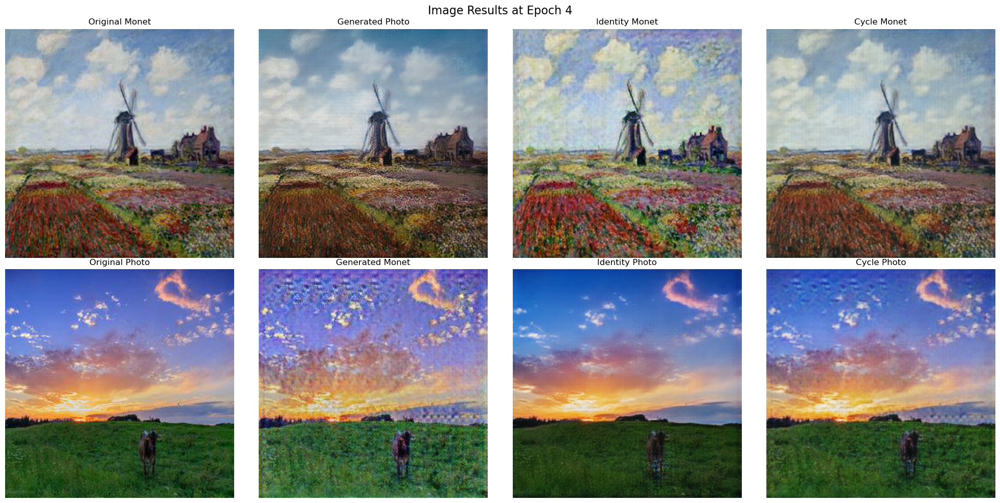

Epoch [5/20] - G_loss: 3.1559, D_Monet_loss: 0.1630, D_Photo_loss: 0.1622


Validation - G_loss: 3.0458, D_Monet_loss: 0.2153, D_Photo_loss: 0.1640
Models saved at epoch 5
Best model updated at epoch 5 with Val G_loss: 3.0458
Current Gen_M2P LR: 0.000200
Current Gen_P2M LR: 0.000200
Current Disc_Monet LR: 0.000200
Current Disc_Photo LR: 0.000200


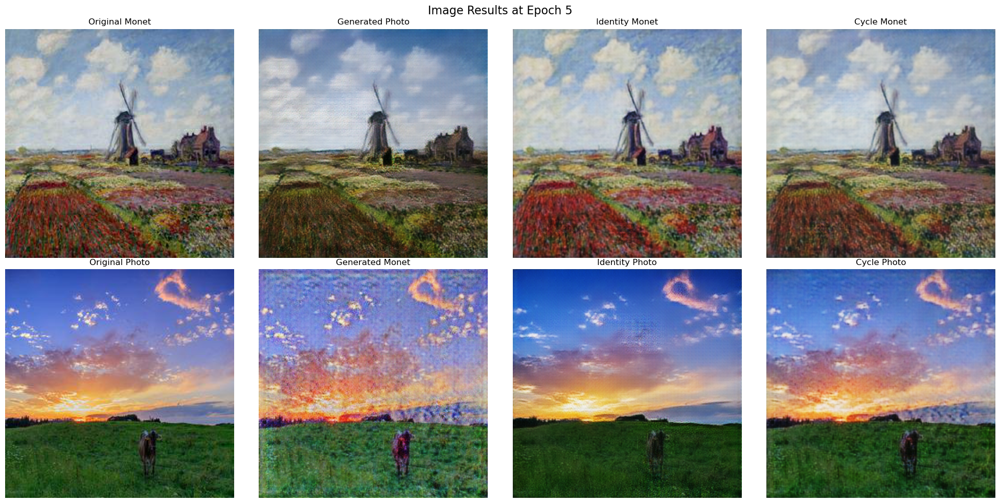

Epoch [6/20] - G_loss: 2.9511, D_Monet_loss: 0.2327, D_Photo_loss: 0.1546


Validation - G_loss: 2.8593, D_Monet_loss: 0.2125, D_Photo_loss: 0.1674
Models saved at epoch 6
Best model updated at epoch 6 with Val G_loss: 2.8593
Current Gen_M2P LR: 0.000200
Current Gen_P2M LR: 0.000200
Current Disc_Monet LR: 0.000100
Current Disc_Photo LR: 0.000200


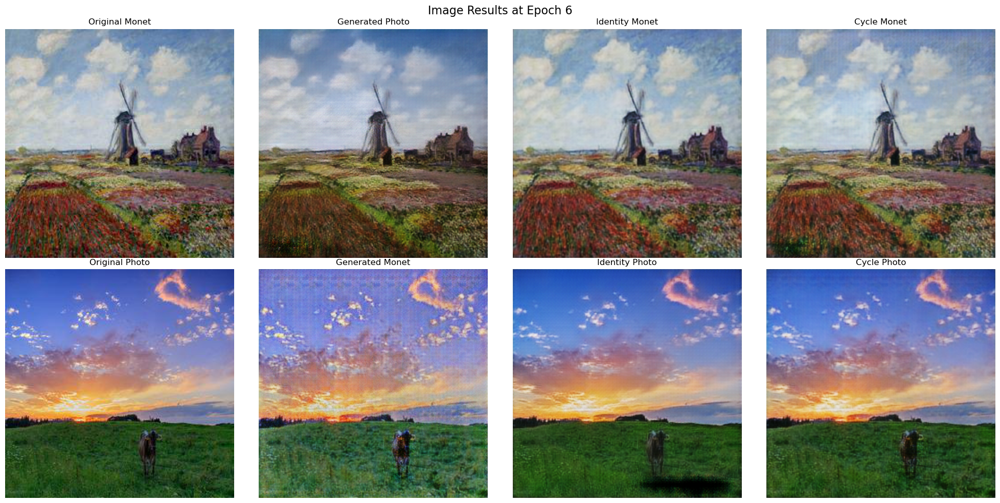

Epoch [7/20] - G_loss: 2.9225, D_Monet_loss: 0.1898, D_Photo_loss: 0.1474


Validation - G_loss: 2.8983, D_Monet_loss: 0.2111, D_Photo_loss: 0.1682
No improvement in validation G_loss for 1 epoch(s).
Current Gen_M2P LR: 0.000200
Current Gen_P2M LR: 0.000200
Current Disc_Monet LR: 0.000100
Current Disc_Photo LR: 0.000200


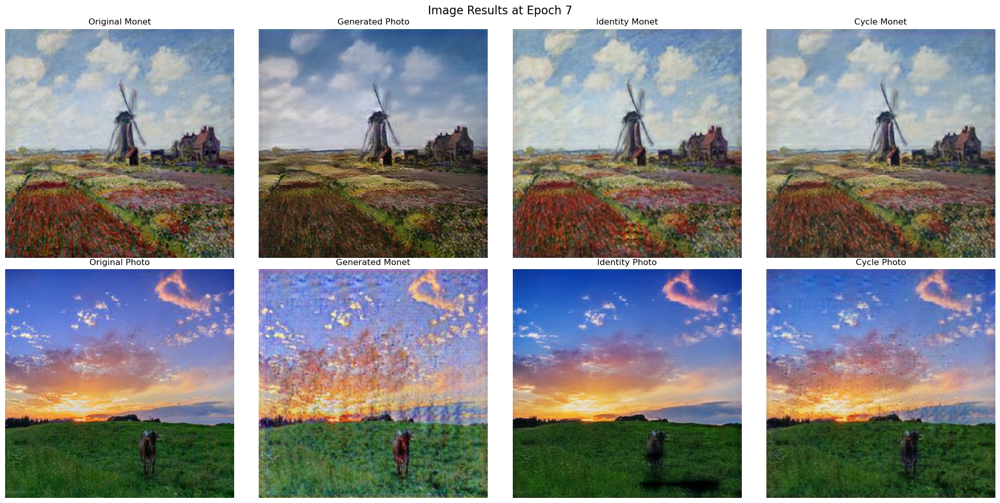

Epoch [8/20] - G_loss: 2.9469, D_Monet_loss: 0.1675, D_Photo_loss: 0.1505


Validation - G_loss: 2.8734, D_Monet_loss: 0.1920, D_Photo_loss: 0.1696
No improvement in validation G_loss for 2 epoch(s).
Current Gen_M2P LR: 0.000200
Current Gen_P2M LR: 0.000200
Current Disc_Monet LR: 0.000100
Current Disc_Photo LR: 0.000100


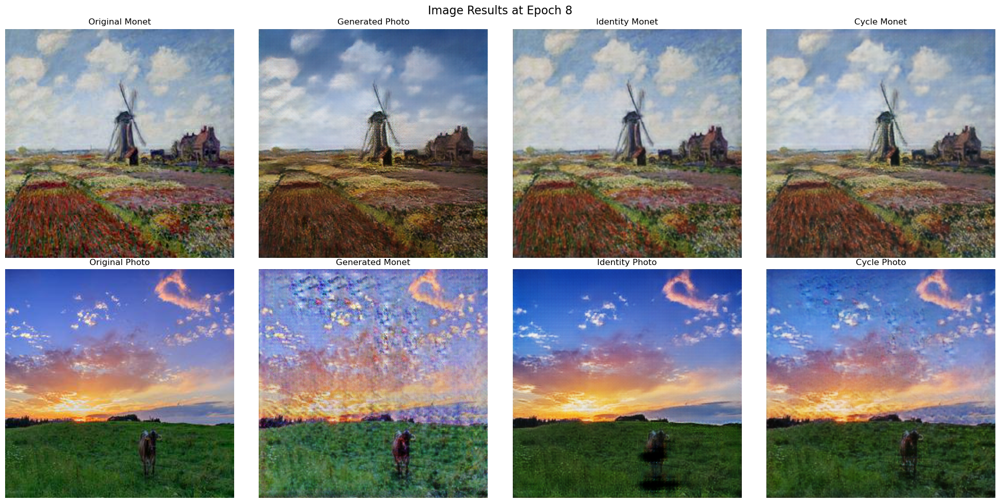

Epoch [9/20] - G_loss: 3.0728, D_Monet_loss: 0.1481, D_Photo_loss: 0.1331


Validation - G_loss: 3.2442, D_Monet_loss: 0.1702, D_Photo_loss: 0.1759
No improvement in validation G_loss for 3 epoch(s).
Current Gen_M2P LR: 0.000100
Current Gen_P2M LR: 0.000100
Current Disc_Monet LR: 0.000100
Current Disc_Photo LR: 0.000100


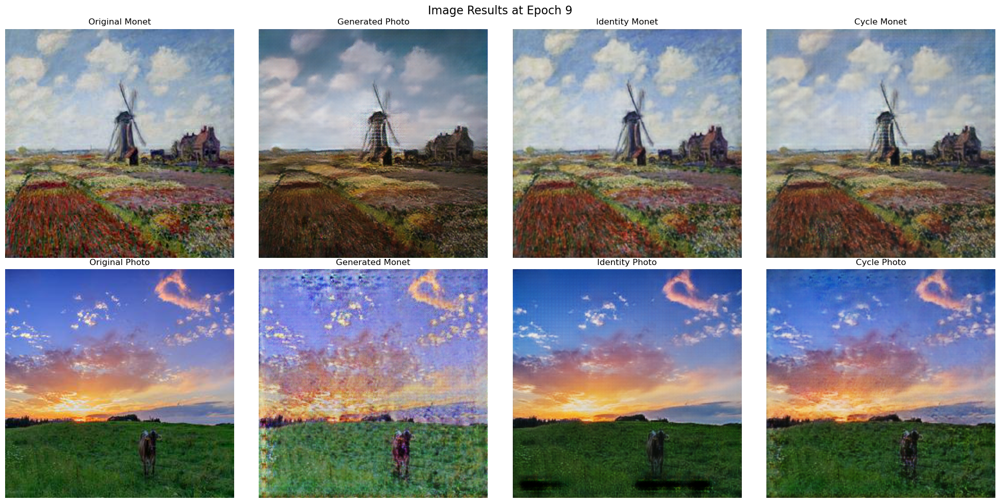

Epoch [10/20] - G_loss: 2.9486, D_Monet_loss: 0.1194, D_Photo_loss: 0.1496


Validation - G_loss: 2.9351, D_Monet_loss: 0.1276, D_Photo_loss: 0.1621
No improvement in validation G_loss for 4 epoch(s).
Current Gen_M2P LR: 0.000100
Current Gen_P2M LR: 0.000100
Current Disc_Monet LR: 0.000100
Current Disc_Photo LR: 0.000100


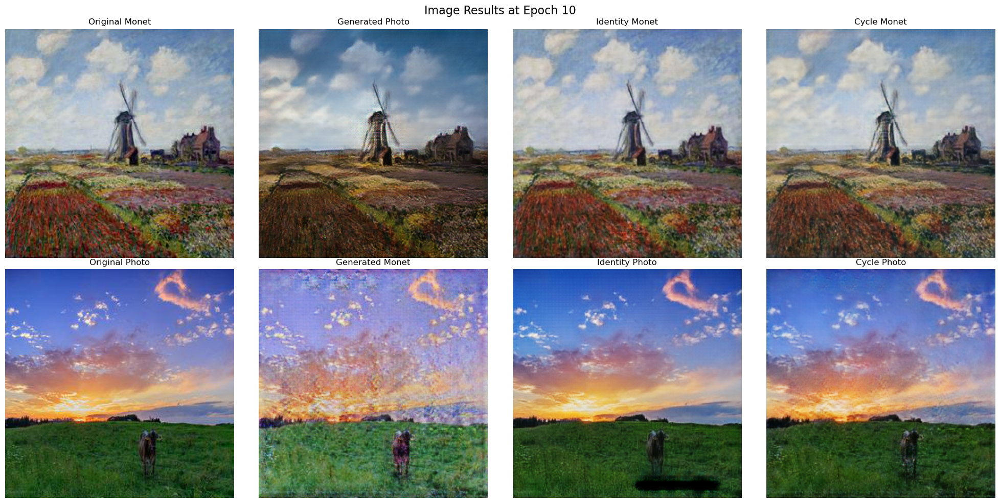

Epoch [11/20] - G_loss: 2.9970, D_Monet_loss: 0.0930, D_Photo_loss: 0.1494


Validation - G_loss: 3.0901, D_Monet_loss: 0.1181, D_Photo_loss: 0.1578
No improvement in validation G_loss for 5 epoch(s).
Early stopping triggered after 5 epochs with no improvement.


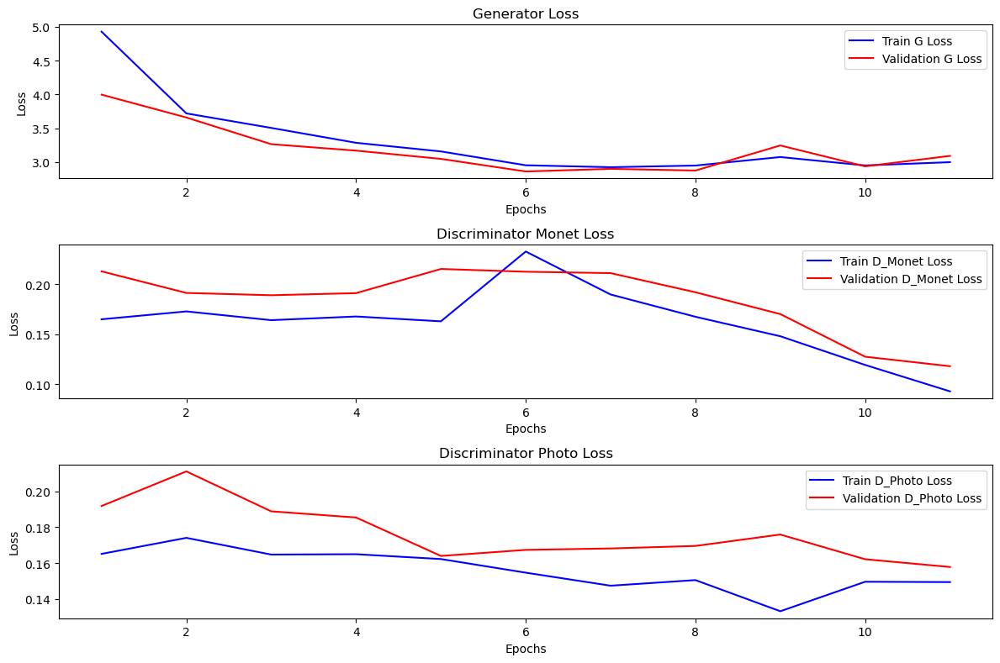

In [28]:
batch_size = 4

train_sample = CustomDataLoader(monet_filenames, photo_filenames, batch_size=batch_size)
monet_train_loader, photo_train_loader = train_sample.setup("train")

val_sample = CustomDataLoader(monet_filenames, photo_filenames, batch_size=batch_size)
monet_val_loader, photo_val_loader = val_sample.setup("val")

# Initialize the Trainer with the necessary components and parameters
trainer = Trainer(
    monet_train_loader = monet_train_loader,
    photo_train_loader = photo_train_loader,
    monet_val_loader = monet_val_loader,
    photo_val_loader = photo_val_loader,
    Gen_M2P = Gen_M2P,
    Gen_P2M = Gen_P2M,
    Disc_Monet = Disc_Monet,
    Disc_Photo = Disc_Photo,
    epochs = epochs,
)

trainer.train()     # Begin the training process and store the training logs for later analysis

### MiFID Calculation
The following code section is used to test MiFID calculations


In [30]:
# Initialize DataLoader
pred_sample = CustomDataLoader(monet_filenames, photo_filenames, batch_size=32)
real_monet, real_photo = pred_sample.setup("pred")

trainer.load_model(trainer.best_epoch)

# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Move the generator to the device
Gen_P2M = trainer.Gen_P2M
Gen_P2M.eval()  # Set to evaluation mode

with torch.no_grad():
    with torch.amp.autocast(device_type='cuda'):  # Mixed precision for validation
        
        mifid = MemorizationInformedFrechetInceptionDistance(feature=2048, normalize=True, reset_real_features=False).to(device)
        values = []
        
        for batch in tqdm(real_monet, desc="Feeding MiFID with Real Monet"):
            real_Monet = batch.to(device)
            real_Monet_mifid = real_Monet * 0.5 + 0.5
            
            mifid.update(real_Monet_mifid, real=True)
            del real_Monet
            del real_Monet_mifid
        
        # Wrap the loop with tqdm for progress bar
        for batch in tqdm(real_photo, desc="Evaluating MiFID"):
            # Move the current batch to the device
            real_Photo = batch.to(device)
            
            # Generate fake Photo
            fake_Monet = Gen_P2M(real_Photo)
            
            # Prepare images for MiFID computation
            fake_Monet_mifid = fake_Monet * 0.5 + 0.5
            
            # Update MiFID with real and fake images
            mifid.update(fake_Monet_mifid, real=False)
            
            # Compute MiFID and store the value
            current_mifid = mifid.compute().item()
            values.append(current_mifid)
            
            # Free memory
            del real_Photo
            del fake_Monet
            del fake_Monet_mifid

            torch.cuda.empty_cache()
        
        # Compute the mean MiFID score
        mean_mifid = np.mean(values)
        print(f"Mean MiFID: {mean_mifid}")
        
        #126.88 com batch_size = 32

Loaded model from checkpoints\Gen_M2P_epoch6.pth to cuda
Loaded model from checkpoints\Gen_P2M_epoch6.pth to cuda
Loaded model from checkpoints\Disc_Monet_epoch6.pth to cuda
Loaded model from checkpoints\Disc_Photo_epoch6.pth to cuda
All models loaded successfully.


Evaluating MiFID: 100%|██████████████████████████████████████████████████████████████| 219/219 [18:36<00:00,  5.10s/it]

Mean MiFID: 105.14954337899543


## Generate images and save them for submission

In [32]:
def generate_and_save_images(generator, dataloader, save_dir="/kaggle/working/images"):
    """
    Generate images using the provided generator and dataloader, and save them.
    """
    
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    generator.eval()
        
    save_path = Path(save_dir)
    save_path.mkdir(parents=True, exist_ok=True)
    
    # Initialize a counter for image filenames
    idx = 0
    
    # Wrap the dataloader with tqdm for a progress bar
    dataloader = tqdm(dataloader, desc='Generating and Saving Images')
    
    with torch.no_grad():
        for real_image in dataloader:
            real_image = real_image.to(device)
            
            fake_image = generator(real_image).squeeze(dim=0)
            fake_image = ((fake_image.permute(1, 2, 0).cpu().detach().numpy() + 1) * 255 / 2).astype('uint8')

            
            Image.fromarray(fake_image).save(f'{save_dir}/monet_{idx}.jpg')
    
            idx += 1
            dataloader.set_postfix(current_idx=idx)
            
    print(f"All generated images have been saved to '{save_dir}'.")

In [33]:
pred_sample = CustomDataLoader(monet_filenames, photo_filenames, batch_size=1)
real_monet, real_photo = pred_sample.setup("pred")

trainer.load_model(trainer.best_epoch)

# Generate and save images
generate_and_save_images(generator=trainer.Gen_P2M, dataloader=real_photo)

!cd /kaggle/working/images && zip -r ../images.zip ./*

Loaded model from checkpoints\Gen_M2P_epoch6.pth to cuda
Loaded model from checkpoints\Gen_P2M_epoch6.pth to cuda
Loaded model from checkpoints\Disc_Monet_epoch6.pth to cuda
Loaded model from checkpoints\Disc_Photo_epoch6.pth to cuda
All models loaded successfully.


Generating and Saving Images: 100%|██████████████████████████████| 7038/7038 [02:03<00:00, 56.96it/s, current_idx=7038]

All generated images have been saved to '/kaggle/working/images'.



'zip' is not recognized as an internal or external command,
operable program or batch file.


## Relevant Literature
1. Goodfellow, I., Pouget-Abadie, J., Mirza, M., Xu, B., Warde-Farley, D., Ozair, S., ... & Bengio, Y. (2014). [*Generative Adversarial Networks* (NeurIPS 2014)](https://dl.acm.org/doi/pdf/10.1145/3422622)
2. Zhu, J., Park, T., Isola, P., & Efros, A. A. (2017). [*Unpaired Image-to-Image Translation using Cycle-Consistent Adversarial Networks* (ICCV 2017)](https://openaccess.thecvf.com/content_ICCV_2017/papers/Zhu_Unpaired_Image-To-Image_Translation_ICCV_2017_paper.pdf)
3. Isola, P., Zhu, J., Zhou, T., & Efros, A. A. (2017). [*Image-to-Image Translation with Conditional Adversarial Networks* (CVPR 2017)](https://openaccess.thecvf.com/content_cvpr_2017/papers/Isola_Image-To-Image_Translation_With_CVPR_2017_paper.pdf)
